In [1]:
%load_ext autoreload
import numpy as np
import pandas as pd
import os
from collections import defaultdict
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, davies_bouldin_score, pairwise_distances
from scipy.spatial.distance import jensenshannon, jaccard, braycurtis
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors, KernelDensity
# %matplotlib notebook
import matplotlib.pyplot as plt
from itertools import combinations
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from mpl_toolkits.mplot3d import Axes3D 
import multiprocessing
from joblib import Parallel, delayed
from utils import filter_paths, js, transform
from tqdm import tqdm_notebook
from numba import cuda, jit, njit, prange, vectorize
from umap import UMAP
%autoreload 2


Bad key "text.kerning_factor" on line 4 in
/media/hpc2_storage/ibulygin/miniconda3/envs/fresh/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [2]:

def transform(method, est, X, parameters, scorer):
    model_inst = method(n_components=2, **parameters, n_jobs=-1)
    X_trans = model_inst.fit_transform(X)
    if np.isnan(X_trans).any():
        return np.inf
    else:
        cv_score = -cross_val_score(est, X_trans, X, scoring=scorer, cv=3, n_jobs=-1).mean()
        return cv_score


In [3]:
datasets_nums = {'AGP':9511, 'ptb':3457, 't2d':1044, 'ibd':86}
color = {'AGP':'red', 'ptb':'green', 't2d':'blue', 'ibd':'purple'}

N = sum([i for i in datasets_nums.values()])
datasets_colors = np.zeros(N).astype(str)
dataset_names = np.zeros(N).astype(str)
i_, i_prev = 0, 0
for k,v in datasets_nums.items():
    datasets_colors[i_prev:i_prev+v] = color[k]
    dataset_names[i_prev:i_prev+v] = k
    i_ += 1
    i_prev += v

# Merged

In [9]:
mask_HMP = (dataset_names != 'AGP')

In [10]:
root_merged = './merged_datasets/'
datasets_merged = {}

for tax_level in ['o', 'f', 'g']:
    dataframe_out = pd.read_csv(f'merged_datasets/pivot_{tax_level}.csv', skipinitialspace=True, sep=';', engine='python')
    dataframe_out = dataframe_out.drop('Unnamed: 0', axis = 1)[mask_HMP]
    data.save(f'./HMP/pivot_{tax_level}_normalized.csv/')

In [28]:
g__abundance_dict = {}
specific_OTUs = ['g__Bacteroides', 'g__Prevotella', 'g__Ruminococcus']
for otu in specific_OTUs:
    g__abundance_dict[otu] = datasets_merged['g'][otu]

In [11]:
@njit
def js_jit(p,q):
    EPS = 1e-10
    dkl_pq = np.sum(p * np.log((p+EPS)/(q + EPS)))
    dkl_qp = np.sum(q * np.log((q+EPS)/(p + EPS)))
    J = (dkl_pq + dkl_qp)/2
    return J

In [13]:
# %%time
# silhouette_score(datasets_merged['o'], y, metric='manhattan')

CPU times: user 15.4 s, sys: 64 ms, total: 15.4 s
Wall time: 15.4 s


0.32512766333857956

# Metrics

In [23]:
results = defaultdict(list)

for tax_level in ['o', 'f', 'g']:
    for metric_name, metric in tqdm_notebook(zip(['jensenshannon','braycurtis', 'euclidean', 'manhattan'],
                                                   [js_jit, braycurtis, 'euclidean', 'manhattan'])):
            
            
            
            ss = silhouette_score(datasets_merged[tax_level], y, metric=metric)
            
            results['Tax level'] = tax_level
            results['Metric name'] = metric_name
            results['Silhouette score'] = ss
            
            print(tax_level, metric_name, data_type, ss, db)

# UMAP 2D

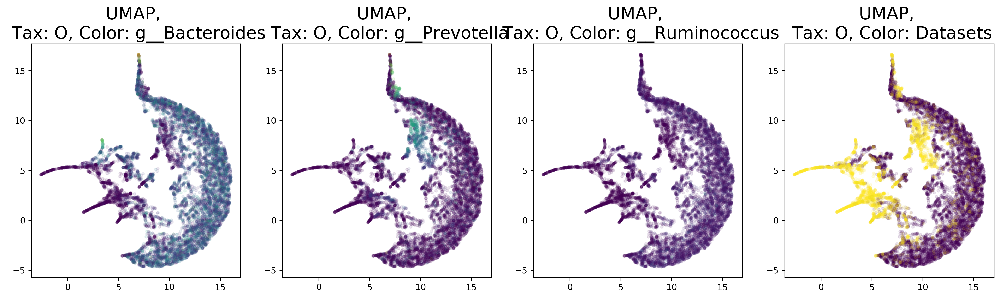

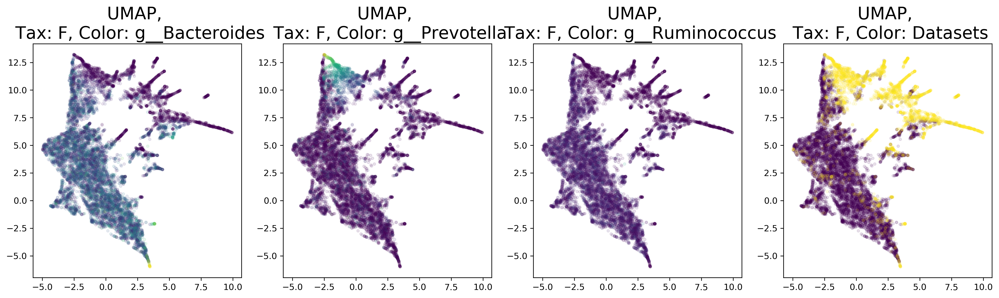

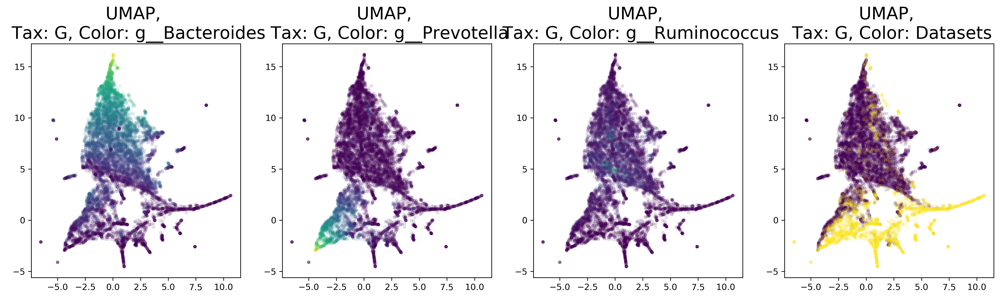

In [36]:
for tax_level in ['o', 'f', 'g']:
    ump = UMAP()
    v = ump.fit_transform(datasets_merged[tax_level].values)
    fig, ax = plt.subplots(ncols=4, nrows=1, figsize=(20,5), dpi=300)
    for otu_number,(k,c) in enumerate(g__abundance_dict.items()):
            # k - OTU name
            # c - values
        ax[otu_number].scatter(v[:,0], v[:,1], marker='.', alpha=0.1,c=c) # , color='black'
        ax[otu_number].set_title(f'UMAP, Tax: {tax_level.upper()},\n Color: {k}', fontsize=20)
#     plt.suptitle('UMAP embeddings', fontsize=20)
    ax[-1].scatter(v[:,0], v[:,1], marker='.', alpha=0.1,c=y) # , color='black'
    ax[-1].set_title(f'UMAP, Tax: {tax_level.upper()},\n Color: Datasets', fontsize=20)
plt.show()

исследовать как возникают аутлаеры в зависимости от таксономического уровня - может это просто редкие OTU

# t-SNE 2D

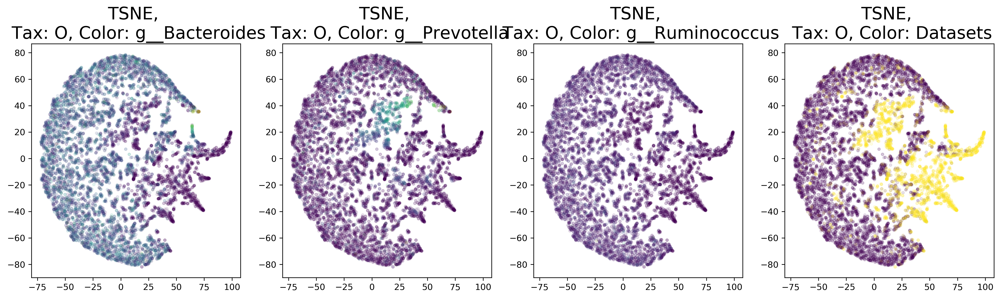

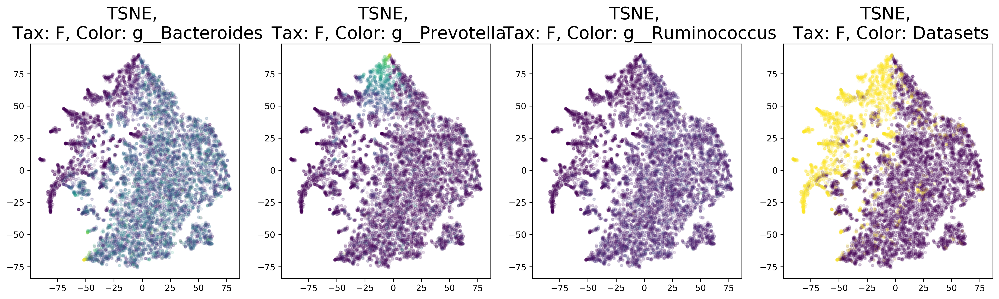

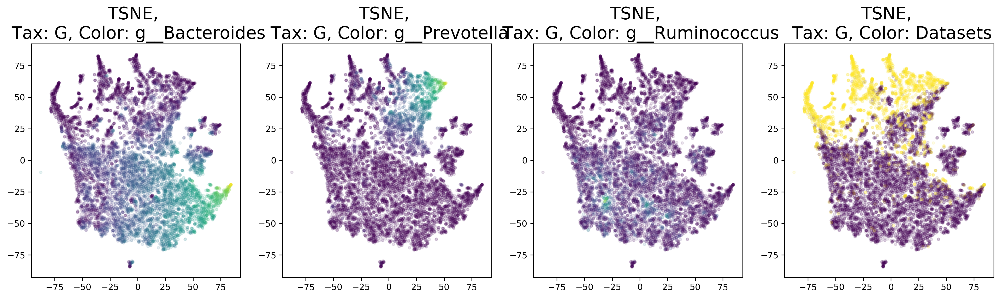

In [38]:
for tax_level in ['o', 'f', 'g']:
    tsne = TSNE()
    v = tsne.fit_transform(datasets_merged[tax_level].values)
    fig, ax = plt.subplots(ncols=4, nrows=1, figsize=(20,5), dpi=300)
    for otu_number,(k,c) in enumerate(g__abundance_dict.items()):
            # k - OTU name
            # c - values
        ax[otu_number].scatter(v[:,0], v[:,1], marker='.', alpha=0.1,c=c) # , color='black'
        ax[otu_number].set_title(f'TSNE, Tax: {tax_level.upper()}, \n Color: {k}', fontsize=20)
    ax[-1].scatter(v[:,0], v[:,1], marker='.', alpha=0.1,c=y) # , color='black'
    ax[-1].set_title(f'TSNE, Tax: {tax_level.upper()}, \n Color: Datasets', fontsize=20)
plt.show()